## Random Forest

Random Forest is an ensemble of Decision Trees. With a few exceptions, a `RandomForestClassifier` has all the hyperparameters of a `DecisionTreeClassifier` (to control how trees are grown), plus all the hyperparameters of a `BaggingClassifier` to control the ensemble itself.

The Random Forest algorithm introduces extra randomness when growing trees; instead of searching for the very best feature when splitting a node, it searches for the best feature among a random subset of features. This results in a greater tree diversity, which (once again) trades a higher bias for a lower variance, generally yielding an overall better model. The following `BaggingClassifier` is roughly equivalent to the previous `RandomForestClassifier`. Run the cell below to visualize a single estimator from a random forest model, using the Iris dataset to classify the data into the appropriate species.

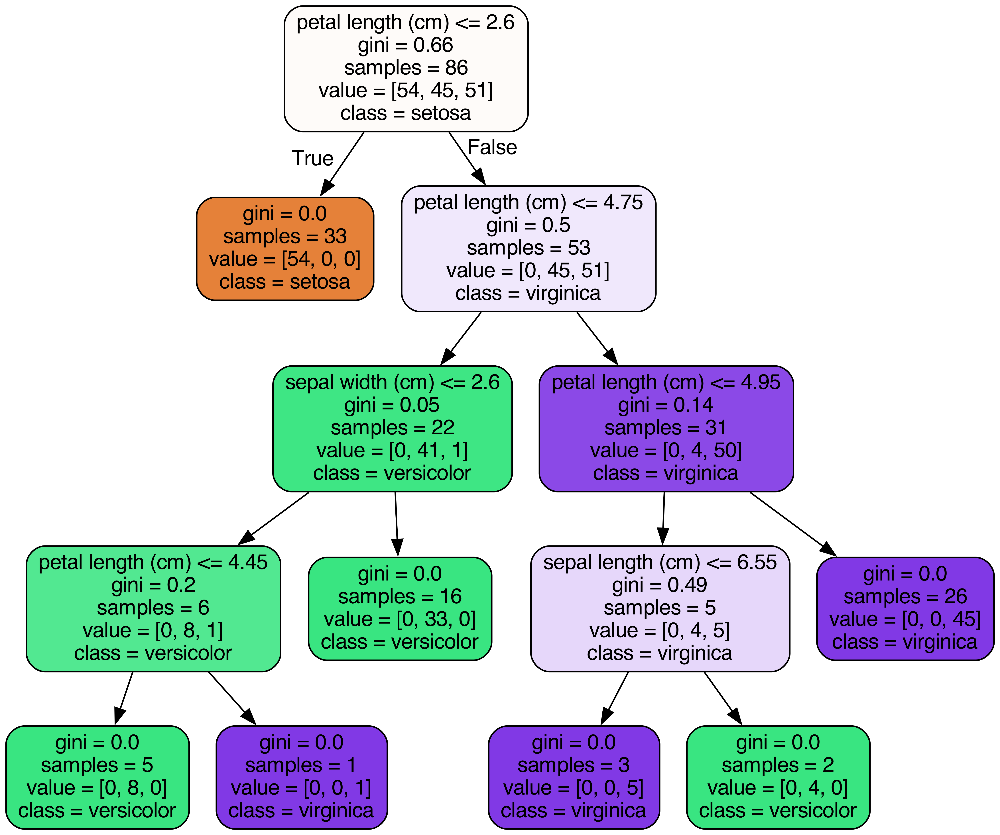

In [270]:
from sklearn.datasets import load_iris
iris = load_iris()

# Model (can also use single decision tree)
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=10) #10 trees in the forest! 10 runs of randomizing

# Train
model.fit(iris.data, iris.target)

# Extract single tree
estimator = model.estimators_[1] #OHHHHHHHHH! THIS IS SIMPLY PICKING *ONE*
#OF THE TREES AKA 'ESTIMATORS' OF THE 10!!!!! so arbitrary!
#don't know if there's a way to spit out all of them at once without iterating -
#like i tried doing like 0:9 and blank brackets and NO brackets but all error!

from sklearn.tree import export_graphviz #loll, 'import export' ;P

# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = iris.feature_names,
                class_names = iris.target_names,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

########################################################################################################

In [ ]:
#we can try iterating to view the others if no other way

Notice how each split seperates the data into buckets of similar observations. This is a single tree and a relatively simple classification dataset, but the same method is used in a more complex dataset with greater depth to the trees.

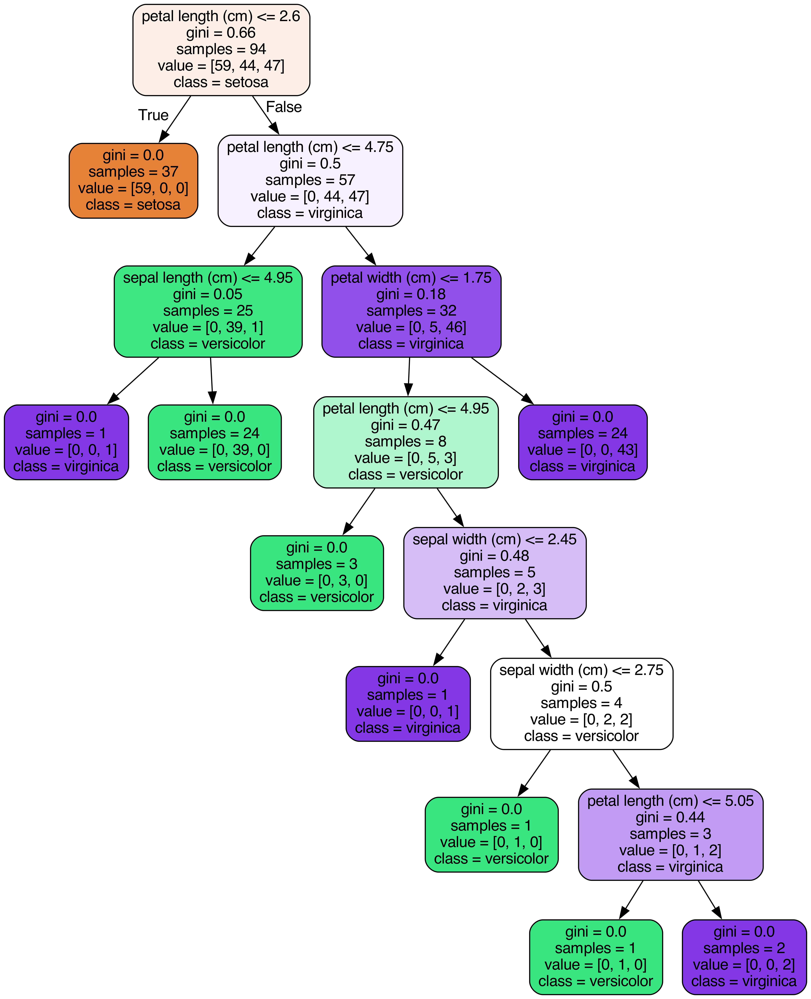

In [5]:
############################################################################################################################################################################
#they keep referencing SINGLE tree, so was i supposed to change n to 1??
#what does 'value' = [,,]mean??

#try n=1:
# Model (can also use single decision tree)
model2 = RandomForestClassifier(n_estimators=1) #SINGLE decision trees in the forest! lol LONE wolf/forest/soldier

# Train
model2.fit(iris.data, iris.target)

# Extract single tree
estimator = model.estimators_[5]


# Export as dot file
export_graphviz(estimator, out_file='tree2.dot', 
                feature_names = iris.feature_names,
                class_names = iris.target_names,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
call(['dot', '-Tpng', 'tree2.dot', '-o', 'tree2.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree2.png')

In [ ]:
#yep, think that's the same
#so yeah it's not like it was some kind of 'averaged' tree of the 10 trees!
############################################################################################################################################################################

#lollll wait! now that i know how this works (i think) - how did this work w/
#putting the 5th [index] estimator if there's only ONE estimator/tree!?!?!?!?!?

############################################################################################################################################################################

## Coronavirus
Coronavirus disease (COVID-19) is an infectious disease caused by a new virus.
The disease causes respiratory illness (like the flu) with symptoms such as a cough, fever, and in more severe cases, difficulty breathing. You can protect yourself by washing your hands frequently, avoiding touching your face, and avoiding close contact (1 meter or 3 feet) with people who are unwell. An outbreak of COVID-19 started in December 2019 and at the time of the creation of this project was continuing to spread throughout the world. Many governments recommended only essential outings to public places and closed most business that do not serve food or sell essential items. An excellent [spatial dashboard](https://www.arcgis.com/apps/opsdashboard/index.html#/bda7594740fd40299423467b48e9ecf6) built by Johns Hopkins shows the daily confirmed cases by country. 

This case study was designed to drive home the important role that data science plays in real-world situations like this pandemic. This case study uses the Random Forest Classifier and a dataset from the South Korean cases of COVID-19 provided on [Kaggle](https://www.kaggle.com/kimjihoo/coronavirusdataset) to encourage research on this important topic. The goal of the case study is to build a Random Forest Classifier to predict the 'state' of the patient.

First, please load the needed packages and modules into Python. Next, load the data into a pandas dataframe for ease of use.

In [28]:
import os
import pandas as pd
from datetime import datetime,timedelta
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
import plotly.graph_objects as go
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import ExtraTreesRegressor #hain?? never used
import datetime


In [9]:
#def used plotly before right?! sounds so familiar - unless just thinking of
#matplotlib PYplot! kinda backwards
# pip install plotly

#successful! aH

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 11.3 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [50]:
url ='SouthKoreaCoronavirusDataset/PatientInfo.csv'
#loll 'url'?? weirdos! not a website address!!
df = pd.read_csv(url)
df.head()

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,2.0,male,1964.0,50s,Korea,Seoul,Gangseo-gu,NaN,overseas inflow,1.0,NaN,75.0,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,5.0,male,1987.0,30s,Korea,Seoul,Jungnang-gu,NaN,overseas inflow,1.0,NaN,31.0,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,6.0,male,1964.0,50s,Korea,Seoul,Jongno-gu,NaN,contact with patient,2.0,2.002000e+09,17.0,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,7.0,male,1991.0,20s,Korea,Seoul,Mapo-gu,NaN,overseas inflow,1.0,NaN,9.0,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,9.0,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,NaN,contact with patient,2.0,1.000000e+09,2.0,NaN,2020-01-31,2020-02-24,NaN,released


In [12]:
df.shape

(2218, 18)

In [83]:
#Counts of null values 
na_df=pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).reset_index()
na_df.columns = ['VarName', 'NullCount']
na_df[(na_df['NullCount']>0)]

,VarName,NullCount
0,deceased_date,2186
1,symptom_onset_date,2025
2,released_date,1995
3,infection_case,1055
4,n_age,454
5,age,261
6,sex,145
7,confirmed_date,141
8,state,88
9,city,65


In [15]:
#just to seee how this looks like, unbridled, broken into parts! evolved
#pd.DataFrame(df.isnull().sum().sort_values(ascending=False))

In [16]:
#counts of response variable values

#ahh okay so 'state' is the TARGET/RESPONSE VARIABLE Y!!! ofc it's the LAST! it's not like 'territory' state, but rather *OUTCOME*!!!! is a better word!!!
#END RESULT! often this is the kinda thing we wanna predict!
#so just like Titanic! tryna predict classification of dead or alive! 0/1
df.state.value_counts()

isolated    1791
released     307
deceased      32
Name: state, dtype: int64

In [271]:
#so: quarantine, recovered, died! first two ofc are survived, SO far!

In [ ]:
#remem, WE can see all the data at once, but the COMPUTER doesn't try to study
#it unless WE tell it; doesn't have a 'free will'!... imagine! if we make em
#so 'smart'/autonomous that they start acting for themselves WITHOUT EXPLICIT COMMANDS!!!
#i mean,... THAT'S WHAT MACHINE LEARNING IS!!! teaching a computer to 'think'
#for itself, giving it 'judgement', empowering it to make its OWN decisions
#teaching him the way, showing him the ropes, TRAINING it, so it can go off
#on its own! so you don't have to be there and hand-hold and tell him
#every time. show him how to understand the GIST of the matter so he can
#recognize a similar situation later as being the same, not getting distracted/
#bogged down by / obsessed w/ details! can recognize something is the same
#without it LITERALLY looking the same!!!

In [ ]:
#interesting!! so for GENERAL image recognition, you DO want the algorithm to
#generalize, like seeing how cats can have many different colors, etc
#but when it comes to facial recognition for a SPECIFIC DEVICE!!!!! like to unlock
#your device, that's a SECURITY CONCERN!!!!! SO IT *BETTER* BE FINE-TUNED TO
#YOUR SPECIFIC LOOK!!!!! WITHOUT SOMEHOW CONFUSING SOMEONE ELSE AS YOU!!!!! BUT BE
#ABLE TO RECOGNIZE IT'S *STILL YOU* EVEN WITH diff looks - glasses, makeup, hair,
#hijab, etc!!! so like it's another good example of where it DEF ABSOLUTELY CANNOT
#afford any FALSE positives (thinking it's you), but can afford some False NEGATIVES
#(thinking/suspecting it's someone ELSE, a 'weak' match) - even tho that'll be
#annoying sometimes - it HAS to be at that level to make sure to SHUT OUT ANY
#POSSIBILITY OF FRAUD!!!!!! breaking in & entry!!!!! think about it - LITERALLY
#like breaking into someone's HOUSE or even WORSE!!!! cuz can potentially now
#have access to like everything! email, passwords, BANK APPS!!! work, personal info,
#etc!!!

################################################################################

 **<font color='teal'> Create a new column named 'n_age' which is the calculated age based on the birth year column.</font>**

In [24]:
datetime.date.today().year

2022

In [51]:
import datetime

#lol doesn't matter which year we put in right! as long as all comparing to same one!
#this was in 2020 and now it's 2022
#could ofc do 2020 if we want no prob
df['n_age'] = datetime.date.today().year - df.birth_year
# df['n_age_2020'] = 2020 - df.birth_year

#we end up throwing this feature away anyway!? so why'd we bother?! lol
#but i guess that's just real life practice! may not KNOW it's useless
#till LATER!!
#or can you just leave all and let the MODEL decide what's important?!
################################################################################

In [29]:
df.head()

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,n_age
0,1000000001,2.0,male,1964.0,50s,Korea,Seoul,Gangseo-gu,NaN,overseas inflow,1.0,NaN,75.0,2020-01-22,2020-01-23,2020-02-05,NaN,released,58.0
1,1000000002,5.0,male,1987.0,30s,Korea,Seoul,Jungnang-gu,NaN,overseas inflow,1.0,NaN,31.0,NaN,2020-01-30,2020-03-02,NaN,released,35.0
2,1000000003,6.0,male,1964.0,50s,Korea,Seoul,Jongno-gu,NaN,contact with patient,2.0,2.002000e+09,17.0,NaN,2020-01-30,2020-02-19,NaN,released,58.0
3,1000000004,7.0,male,1991.0,20s,Korea,Seoul,Mapo-gu,NaN,overseas inflow,1.0,NaN,9.0,2020-01-26,2020-01-30,2020-02-15,NaN,released,31.0
4,1000000005,9.0,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,NaN,contact with patient,2.0,1.000000e+09,2.0,NaN,2020-01-31,2020-02-24,NaN,released,30.0


### Handle Missing Values

 **<font color='teal'> Print the number of missing values by column.</font>**

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2218 entries, 0 to 2217
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   patient_id          2218 non-null   int64  
 1   global_num          1314 non-null   float64
 2   sex                 2073 non-null   object 
 3   birth_year          1764 non-null   float64
 4   age                 1957 non-null   object 
 5   country             2218 non-null   object 
 6   province            2218 non-null   object 
 7   city                2153 non-null   object 
 8   disease             19 non-null     object 
 9   infection_case      1163 non-null   object 
 10  infection_order     42 non-null     float64
 11  infected_by         469 non-null    float64
 12  contact_number      411 non-null    float64
 13  symptom_onset_date  193 non-null    object 
 14  confirmed_date      2077 non-null   object 
 15  released_date       223 non-null    object 
 16  deceas

In [40]:
#more direct way to see what's missing!! how many!
df.isna().sum().sort_values(ascending=False)

disease               2199
deceased_date         2186
infection_order       2176
symptom_onset_date    2025
released_date         1995
contact_number        1807
infected_by           1749
infection_case        1055
global_num             904
n_age                  454
birth_year             454
age                    261
sex                    145
confirmed_date         141
state                   88
city                    65
province                 0
country                  0
patient_id               0
dtype: int64

In [ ]:
#oh wait lol DIDN'T WE JUST/ALREADY DO THIS UP THERE BEFORE!?

 **<font color='teal'> Fill the 'disease' missing values with 0 and remap the True values to 1.</font>**

In [42]:
len(df)

2218

In [ ]:
#wow, so almost ALL of the entries for many of these vars are blank!!!/missing

In [53]:
df.disease.fillna(0,inplace=True)

In [54]:
df

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,n_age
0,1000000001,2.0,male,1964.0,50s,Korea,Seoul,Gangseo-gu,0,overseas inflow,1.0,NaN,75.0,2020-01-22,2020-01-23,2020-02-05,NaN,released,58.0
1,1000000002,5.0,male,1987.0,30s,Korea,Seoul,Jungnang-gu,0,overseas inflow,1.0,NaN,31.0,NaN,2020-01-30,2020-03-02,NaN,released,35.0
2,1000000003,6.0,male,1964.0,50s,Korea,Seoul,Jongno-gu,0,contact with patient,2.0,2.002000e+09,17.0,NaN,2020-01-30,2020-02-19,NaN,released,58.0
3,1000000004,7.0,male,1991.0,20s,Korea,Seoul,Mapo-gu,0,overseas inflow,1.0,NaN,9.0,2020-01-26,2020-01-30,2020-02-15,NaN,released,31.0
4,1000000005,9.0,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,0,contact with patient,2.0,1.000000e+09,2.0,NaN,2020-01-31,2020-02-24,NaN,released,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2213,6100000085,NaN,male,1990.0,30s,Korea,Gyeongsangnam-do,Changwon-si,0,NaN,NaN,NaN,NaN,NaN,2020-03-16,NaN,NaN,NaN,32.0
2214,7000000001,139.0,male,1998.0,20s,Korea,Jeju-do,Jeju-do,0,etc,NaN,NaN,87.0,NaN,2020-02-20,NaN,NaN,isolated,24.0
2215,7000000002,222.0,female,1998.0,20s,Korea,Jeju-do,Jeju-do,0,etc,NaN,NaN,84.0,NaN,2020-02-22,2020-03-07,NaN,released,24.0
2216,7000000003,4345.0,female,1972.0,40s,Korea,Jeju-do,etc,0,etc,NaN,NaN,21.0,NaN,2020-03-02,2020-03-15,NaN,released,50.0


In [55]:
df.disease.unique()

array([0, True], dtype=object)

In [56]:
df.disease.value_counts()

0       2199
True      19
Name: disease, dtype: int64

In [74]:
df.disease.replace(True,1,inplace=True)

In [75]:
df.disease.value_counts()

0    2199
1      19
Name: disease, dtype: int64

In [76]:
df.disease.unique()

array([0, 1])

In [ ]:
########################################
#OHHHH so when it's 'True' you gotta just LEAVE as True, plain! don't put in
#quotes!
########################################

 **<font color='teal'> Fill null values in the following columns with their mean: 'global_number','birth_year','infection_order','infected_by'and 'contact_number'</font>**

In [81]:
# from sklearn.pipeline import Pipeline
# from sklearn.impute import SimpleImputer

# imp_mean = SimpleImputer() #by default strategy is MEAN!!!

# steps = [("imputer", imputer)]
# pipeline = Pipeline(steps)
#good thought doesn't make sense to do when that's ALL we wanna do
#lol, this is for when wanna COMBINE/PACKAGE/COMBO w/ fitting model!!!

# imp_mean.df['global_num'] #lol ofc, they wrote 'global_number' but it's just global_num....

#ohhh wait a minute... is this ONLY for use with fitting/modeling??

#oh lol, just gotta do what we just did, : .fillna()!

#don't use pipeline here cuz that's when we're combining all in one, like scaling
#+ fitting... which i guess we COULD do here??
##############################################################################

df_restore = df.copy()

#coulda done iteratively!

df['global_num'].fillna(df['global_num'].mean(),inplace=True)
df['birth_year'].fillna(df['birth_year'].mean(),inplace=True)
df['infection_order'].fillna(df['infection_order'].mean(),inplace=True)
df['infected_by'].fillna(df['infected_by'].mean(),inplace=True)
df['contact_number'].fillna(df['contact_number'].mean(),inplace=True)

In [86]:
############################################
#so i'm not sure if this'll just spit whatever it was when we
#ran earlier, at beginning, like is this var just saving
#that output? i think so. if we want it to actually
#EXECUTE that code, gotta rewrite that code or do as a FUNCTION!!!
#raw code:
#versioning just in case lol, good practice?
na_df2=pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).reset_index()
na_df2.columns = ['VarName', 'NullCount']
na_df2[(na_df2['NullCount']>0)]

#oh lol so if just putting the variable won't execute the code
#stored behind it, it's only the OUTPUT of the code,
#then there's no point in even storing it!!!
############################################

,VarName,NullCount
0,deceased_date,2186
1,symptom_onset_date,2025
2,released_date,1995
3,infection_case,1055
4,n_age,454
5,age,261
6,sex,145
7,confirmed_date,141
8,state,88
9,city,65


 **<font color='teal'> Fill the rest of the missing values with any method.</font>**

In [89]:
#okay so we got:
na_df2[(na_df2['NullCount']>0)].VarName.values

array(['deceased_date', 'symptom_onset_date', 'released_date',
       'infection_case', 'n_age', 'age', 'sex', 'confirmed_date', 'state',
       'city'], dtype=object)

In [90]:
df_restore2 = df.copy()

In [119]:
#just to make sure it's okay!
df_restore2.head()

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,n_age
0,1000000001,2.0,male,1964.0,50s,Korea,Seoul,Gangseo-gu,0,overseas inflow,1.0,2.600789e+09,75.0,2020-01-22,2020-01-23,2020-02-05,NaN,released,58.0
1,1000000002,5.0,male,1987.0,30s,Korea,Seoul,Jungnang-gu,0,overseas inflow,1.0,2.600789e+09,31.0,NaN,2020-01-30,2020-03-02,NaN,released,35.0
2,1000000003,6.0,male,1964.0,50s,Korea,Seoul,Jongno-gu,0,contact with patient,2.0,2.002000e+09,17.0,NaN,2020-01-30,2020-02-19,NaN,released,58.0
3,1000000004,7.0,male,1991.0,20s,Korea,Seoul,Mapo-gu,0,overseas inflow,1.0,2.600789e+09,9.0,2020-01-26,2020-01-30,2020-02-15,NaN,released,31.0
4,1000000005,9.0,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,0,contact with patient,2.0,1.000000e+09,2.0,NaN,2020-01-31,2020-02-24,NaN,released,30.0


In [95]:
df.infection_case.unique()

array(['overseas inflow', 'contact with patient', 'Seongdong-gu APT',
       'etc', "Eunpyeong St. Mary's Hospital", 'Shincheonji Church',
       'Dongan Church', 'Guro-gu Call Center', 'Onchun Church',
       'Cheongdo Daenam Hospital', 'Suyeong-gu Kindergarten', nan,
       'Ministry of Oceans and Fisheries', 'gym facility in Cheonan',
       'gym facility in Sejong', 'River of Grace Community Church',
       'Pilgrimage to Israel'], dtype=object)

In [99]:
df.state.unique()

array(['released', 'isolated', 'deceased', nan], dtype=object)

In [100]:
df.sex.unique()

array(['male', 'female', nan], dtype=object)

In [102]:
df.age.unique()

array(['50s', '30s', '20s', '60s', '80s', '70s', '40s', '10s', '90s',
       '0s', nan, '100s'], dtype=object)

In [103]:
#OHHHH WAIT!
#so lol the ONLY one left is n_age and that's CALCULATED!
#may have to recalculate/rerun
#but yeah age is actually CATEGORICAL! lol like decades, 50s, 60s etc!
#not exact!
#so the we can just simply do ALL as mode! cuz all STRINGS!!!
#/DATES!!!!

############################################################

In [ ]:
############################################################
######WOOOOOOOOOWWWWWWWWWWW###########
#so literally all i hadda do was put a [0] after mode()!!!!!
#for some odd reason, .mode() outputs with the INDEX! so you
#gotta subset it! doesn't have anything to do w/ it being
#a string! same would apply if you wanted to use .mode() for a
#numerical column!!!!! mean & median don't do that!!! those
#output as single values themselves!!!!!

In [ ]:
#####IGNORE#######
#hmmm iterator didn't work?? just do manually again
############################################################
#OHHHH! okay, weird, yeah somehow 'df' got corrupted!!!
#don't know how!!! says "maximum recursion depth exceeded while calling a Python object
#Output exceeds the size limit. Open the full output data in a text editor"
#weird tho that it let me even REFERENCE df w/o error!
#okay so ALHAMDULILLAH for the restore coppies!!!
#we'll go back to the iterative version then iA and iA it works!
# df['deceased_date'].fillna(df['deceased_date'].mode(),inplace=True)
# df['symptom_onset_date'].fillna(df['symptom_onset_date'].mode(),inplace=True)
# df['released_date'].fillna(df['released_date'].mode(),inplace=True)
# df['confirmed_date'].fillna(df['confirmed_date'].mode(),inplace=True)
# df['infection_case'].fillna(df['infection_case'].mode(),inplace=True)
# df['age'].fillna(df['age'].mode(),inplace=True)
# df['sex'].fillna(df['sex'].mode(),inplace=True)
# df['state'].fillna(df['state'].mode(),inplace=True)
# df['city'].fillna(df['city'].mode(),inplace=True)

In [147]:
#dates & categoricals we'll do MODE! since mean/median etc don't apply! but mode works for ALL!

null_cols = ['deceased_date', 'symptom_onset_date', 'released_date', 'confirmed_date', 'infection_case', 'age', 'sex', 'state', 'city']

for i in null_cols:
       df[i].fillna(df[i].mode()[0],inplace=True)

#so then yeah we coulda used iterator for the last step
#of mean filling, and also coulda used the long manual way here,
#just woulda needed the [0]!!!!!!


In [148]:
df.head()

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state,n_age
0,1000000001,2.0,male,1964.0,50s,Korea,Seoul,Gangseo-gu,0,overseas inflow,1.0,2.600789e+09,75.0,2020-01-22,2020-01-23,2020-02-05,2020-02-23,released,58.0
1,1000000002,5.0,male,1987.0,30s,Korea,Seoul,Jungnang-gu,0,overseas inflow,1.0,2.600789e+09,31.0,2020-02-27,2020-01-30,2020-03-02,2020-02-23,released,35.0
2,1000000003,6.0,male,1964.0,50s,Korea,Seoul,Jongno-gu,0,contact with patient,2.0,2.002000e+09,17.0,2020-02-27,2020-01-30,2020-02-19,2020-02-23,released,58.0
3,1000000004,7.0,male,1991.0,20s,Korea,Seoul,Mapo-gu,0,overseas inflow,1.0,2.600789e+09,9.0,2020-01-26,2020-01-30,2020-02-15,2020-02-23,released,31.0
4,1000000005,9.0,female,1992.0,20s,Korea,Seoul,Seongbuk-gu,0,contact with patient,2.0,1.000000e+09,2.0,2020-02-27,2020-01-31,2020-02-24,2020-02-23,released,30.0


In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN!!!!!!

In [144]:
df['deceased_date'].mode()


0    2020-02-23
dtype: object

In [145]:
df['deceased_date'].mode()[0]

'2020-02-23'

In [ ]:
#woooooow!!!!!! so mean & median don't do that!!!!!!
#it's only MODE for some reason!!!!!!

In [153]:
df['n_age'].mean()


47.01133786848072

In [154]:
df['n_age'].median()


47.5

 **<font color='teal'> Check for any remaining null values.</font>**

In [149]:
na_df3=pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).reset_index()
na_df3.columns = ['VarName', 'NullCount']
na_df3[(na_df3['NullCount']>0)]

,VarName,NullCount
0,n_age,454


In [155]:
df_restore3 = df.copy()

In [156]:
#OKAY ALHAMDULILLAH! so good - this is what we anticipated!
#i guess we coulda filled in n_age, but since it's CALCULATED,
#we can just RERUN!

#iA this will just replace?!
df['n_age'] = datetime.date.today().year - df.birth_year


In [157]:
na_df4=pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).reset_index()
na_df4.columns = ['VarName', 'NullCount']
na_df4[(na_df4['NullCount']>0)]

,VarName,NullCount


In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEEEEEEEN!!!!!!!

In [158]:
df_restore4 = df.copy()

Remove date columns from the data.


In [ ]:
#OH WHATTHA HIGGI SIGGI!!!!!! WHY DIDN'T YOU DO THIS *BEFORE*
#WE FILLED THEM IN!?!?!??!?!!?
#like not even like we're SAVING these/setting them aside!!!!!
#baaa humbug!
#WHY DID WE EVEN BOTHER FILLING THEM IN IF WE WERE JUST GONNA DELETE THEM?!?!?! #beefin

In [ ]:
#prepping us for the real world eh? lol

In [159]:
df = df.drop(['symptom_onset_date','confirmed_date','released_date','deceased_date'],axis =1)

In [ ]:
#########
#COULDA USED SELECT_DTYPES(EXCLUDE=['DATETIME'])!!!!!

Review the count of unique values by column.

In [163]:
# print(df.nunique()) #>>you don't needa be all fancy fam! do same thing w/ less!
df.nunique().sort_values(ascending=False)

patient_id         2218
global_num         1304
infected_by         207
city                134
birth_year           97
n_age                97
contact_number       73
province             17
infection_case       16
age                  11
infection_order       7
country               4
state                 3
sex                   2
disease               2
dtype: int64

In [164]:
len(df)

2218

In [ ]:
#okay good! don't know why .unique doesn't tell you the total
#number of rows? but anyway, i wanted to do this to confirm
#that MAKES SENSE THAT PATIENT_ID HAS THE MOST UNIQUE VALUES
#AND SUSPECTED THAT THAT NUMBER WAS SIMPLY THE NUMBER OF *ROWS*
#/RECORDS AND IT IS!!!!! WHICH MAKES SENSE CUZ THERE SHOULD ALWAYS
#BE SOMETHING UNIQUE/IDENTIFIER FOR EVERY INDIVIDUAL RECORD!!!!
#in this case, PERSON/PATIENT!!!!!
#if not, the INDEX will do it lol
#so yeah, they did it right!

#btw, if ALL features in a row are empty/missing,... DOES
#IT COUNT THAT ROW!?!?

############################################################


In [165]:
df_restore5 = df.copy()

Review the percent of unique values by column.

In [169]:
# print(df.nunique()/df.shape[0])

#ALHAMDULILLAH MY WAY WAY BETTER!!!!! SHORTER FOR EXACT SAME THING! then i make up for it and then some w/ my waste trash talk & excessive celebrations lolllll #showboating
df.nunique()/len(df)

patient_id         1.000000
global_num         0.587917
sex                0.000902
birth_year         0.043733
age                0.004959
country            0.001803
province           0.007665
city               0.060415
disease            0.000902
infection_case     0.007214
infection_order    0.003156
infected_by        0.093327
contact_number     0.032913
state              0.001353
n_age              0.043733
dtype: float64

In [170]:
#sortie
(df.nunique()/len(df)).sort_values(ascending=False)

patient_id         1.000000
global_num         0.587917
infected_by        0.093327
city               0.060415
birth_year         0.043733
n_age              0.043733
contact_number     0.032913
province           0.007665
infection_case     0.007214
age                0.004959
infection_order    0.003156
country            0.001803
state              0.001353
sex                0.000902
disease            0.000902
dtype: float64

In [ ]:
#would be helpful if we had EXPLANATIONS for the exact MEANINGS
#OF ALL THESE COLUMNS!!!!!

Review the range of values per column.

In [172]:
#good call T!
# df.describe().T
#lemme one better it!
df.describe().T[['min','max']]
######################################################

,min,max
patient_id,1.000000e+09,7.000000e+09
global_num,1.000000e+00,8.717000e+03
birth_year,1.916000e+03,2.020000e+03
disease,0.000000e+00,1.000000e+00
infection_order,1.000000e+00,6.000000e+00
infected_by,1.000000e+09,6.113000e+09
contact_number,0.000000e+00,1.160000e+03
n_age,2.000000e+00,1.060000e+02


In [273]:
#ACTUALLY AN EVEN SHORTER WAY!!! AND NOTICE THE OUTPUT IS MUCH CLEANER!
#and interestingly DOES give a value for even the STRING/CATEGORICAL ONES!? LOL
df.agg([min,max]).T

,min,max
patient_id,1000000001,7000000004
global_num,1.0,8717.0
sex,female,male
birth_year,1916.0,2020.0
age,0s,90s
country,China,Thailand
province,Busan,Ulsan
city,Andong-si,pocheon-si
disease,0,1
infection_case,Cheongdo Daenam Hospital,overseas inflow


In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN!

#how to get it outta scientific notation tho!? lol
#######################################################

#and is this to show us that we should be SCALING?? >> WE WILL BE LATER!

### Check for duplicated rows

In [173]:
duplicateRowsDF = df[df.duplicated()]
duplicateRowsDF

,patient_id,global_num,sex,birth_year,age,country,province,city,disease,infection_case,infection_order,infected_by,contact_number,state,n_age


In [ ]:
#NICE AH! NUTHTHEEEEEEIN!
#maybe some got some depending on what fill method they chose?

Print the categorical columns and their associated levels.

In [174]:
########################################################################
#SOMETHING NEW!!!
dfo = df.select_dtypes(include=['object'], exclude=['datetime'])
# dfo.shape
dfo

,sex,age,country,province,city,infection_case,state
0,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,released
1,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,released
2,male,50s,Korea,Seoul,Jongno-gu,contact with patient,released
3,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,released
4,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,released
...,...,...,...,...,...,...,...
2213,male,30s,Korea,Gyeongsangnam-do,Changwon-si,contact with patient,isolated
2214,male,20s,Korea,Jeju-do,Jeju-do,etc,isolated
2215,female,20s,Korea,Jeju-do,Jeju-do,etc,released
2216,female,40s,Korea,Jeju-do,etc,etc,released


In [ ]:
#ohhhh okay, so this subsets the df COLUMNS based on TYPE!
#so ALL rows will show, but COLUMNS will be hidden!

#so if you SPECIFY 'include', DOESN'T THAT AUTOMATICALLY/NECESSARILY
#EXCLUDE ***EVERYTHING*** ELSE!?! aka YOU DON'T NEEDA SPECIFY BOTH!!!
#ONE OR OTHER!!! cuz like say there's 3 types - if you include one,
#and exclude a different one, THEN WHAT WOULD HAPPEN W/ THE THIRD?!?
#would it automatically get excluded?? or automatically INCLUDED???

#but let's try my idea below and see if it gets us same thing!
######################################################################

In [178]:
############################################################
#note this function in python!
dfo = df.select_dtypes(include=['object'])
dfo

,sex,age,country,province,city,infection_case,state
0,male,50s,Korea,Seoul,Gangseo-gu,overseas inflow,released
1,male,30s,Korea,Seoul,Jungnang-gu,overseas inflow,released
2,male,50s,Korea,Seoul,Jongno-gu,contact with patient,released
3,male,20s,Korea,Seoul,Mapo-gu,overseas inflow,released
4,female,20s,Korea,Seoul,Seongbuk-gu,contact with patient,released
...,...,...,...,...,...,...,...
2213,male,30s,Korea,Gyeongsangnam-do,Changwon-si,contact with patient,isolated
2214,male,20s,Korea,Jeju-do,Jeju-do,etc,isolated
2215,female,20s,Korea,Jeju-do,Jeju-do,etc,released
2216,female,40s,Korea,Jeju-do,etc,etc,released


In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN IT DOES!!!

In [ ]:
#OHHHH WAIT A MINUTE!!!! maybe these are exactly the same cuz
#THERE ARE NO DATETIME COLUMNS ANYMORE!?!?
#CUZ REMEM WE DELETED ALL THOSE EARLIER!!!!!!
#SO THEY COULDA USED THIS ALSO AS A WAY TO GET RID OF THEM!!!!!!

In [275]:
df.dtypes

patient_id           int64
global_num         float64
sex                 object
birth_year         float64
age                 object
country             object
province            object
city                object
disease              int64
infection_case      object
infection_order    float64
infected_by        float64
contact_number     float64
state               object
n_age              float64
dtype: object

In [180]:
#get levels for all variables
vn = pd.DataFrame(dfo.nunique()).reset_index()
vn.columns = ['VarName', 'LevelsCount']
vn.sort_values(by='LevelsCount', ascending=False)
# vn >> #OHHH honnneyyy!!!! the output wasn't sorted cuz we
#DIDN'T OVERWRITE/SAVE INPLACE!!!!!! so this only recorded up/
#down to the column names! it is annoying how some things
#require inplace and others don't

,VarName,LevelsCount
4,city,134
3,province,17
5,infection_case,16
1,age,11
2,country,4
6,state,3
0,sex,2


In [ ]:
#ohhh, was like, what the heck are levels?!

#that's a weird name... just means unique values/LABELS,
#if that's what they meant?? lol, maybe w/ accent
#categories

#oh but wait a minute... THIS ISN'T SORTED!!! even tho
#we commanded it! lol
#>>fixed! lol their bad again #bloopers


#and why "vn"??? >> oh, 'VarName'? (1st column)
#and why df"o"?? "object"?

#################################################################

In [186]:
#let's see the rest / the BALANCE/INVERSE!

dfo_num = df.select_dtypes(exclude=['object']) #just changed it from include to exclude!
dfo_num.head()


,patient_id,global_num,birth_year,disease,infection_order,infected_by,contact_number,n_age
0,1000000001,2.0,1964.0,0,1.0,2.600789e+09,75.0,58.0
1,1000000002,5.0,1987.0,0,1.0,2.600789e+09,31.0,35.0
2,1000000003,6.0,1964.0,0,2.0,2.002000e+09,17.0,58.0
3,1000000004,7.0,1991.0,0,1.0,2.600789e+09,9.0,31.0
4,1000000005,9.0,1992.0,0,2.0,1.000000e+09,2.0,30.0


In [187]:
dfo_num.columns

Index(['patient_id', 'global_num', 'birth_year', 'disease', 'infection_order',
       'infected_by', 'contact_number', 'n_age'],
      dtype='object')

In [188]:
vndf = pd.DataFrame(dfo_num.nunique()).reset_index()
vndf.columns = ['VarName', 'LevelsCount']
vndf.sort_values(by='LevelsCount', ascending=False)

,VarName,LevelsCount
0,patient_id,2218
1,global_num,1304
5,infected_by,207
2,birth_year,97
7,n_age,97
6,contact_number,73
4,infection_order,7
3,disease,2


In [190]:
#so from this you can tell that disease for sure is CAT!!!
#infection order is suss......
df.infection_order.unique()

array([1.        , 2.        , 3.        , 4.        , 5.        ,
       2.28571429, 6.        ])

**<font color='teal'> Plot the correlation heat map for the features.</font>**

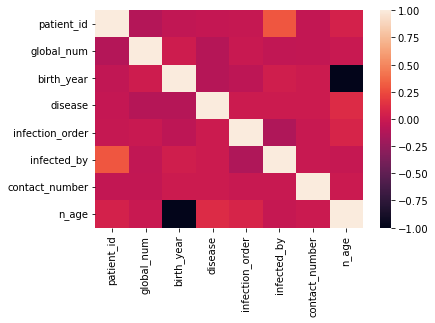

In [182]:
sns.heatmap(df.corr());

In [ ]:
#ofc age & birthyear are PERFECTLY correlated lol cuz age COMES
#from birthyear as a calculation!!!

#lol wouldn't it make more sense for these heat maps to be TRIANGLES, SPLIT IN HALF!?

########################################################################################

#but yeah so the only one that stands out is infected_by vs. patient_id.... wait a minute....
#HOW CAN PATIENT_ID BE CORRELATED WITH *ANYTHING*?!?!?!
#in fact,... WE SHOULD EXCLUDE THAT!!!!! just like we made a separate df for the cats,
#can do something like that for ones we wanna find correlation for!

#and actually, INSTEAD OF DOING SCATTS OF/FOR EVERY COMBO OF X FEATURES, CAN JUST DO THIS
# .CORR() HEATMAP!!!

#OHH!!! AND if you notice, this ONLY DOES *NUMERICAL* FEATURES ANYWAY!!!!!!
#so we don't have to worry about separating those out!
#idk if that's what they were tryna do w/ dfo? although that was saving the CATEGORICALS,
#but not necess separating off / cordoning NUMERICALS!
#lol sounds like "miracles" 
########################################################################################


**<font color='teal'> Plot the boxplots to check for outliers. </font>**

In [184]:
#numerical features
set(df.columns) - set(dfo.columns)

{'birth_year',
 'contact_number',
 'disease',
 'global_num',
 'infected_by',
 'infection_order',
 'n_age',
 'patient_id'}

In [ ]:
#remove discrete/binary ones

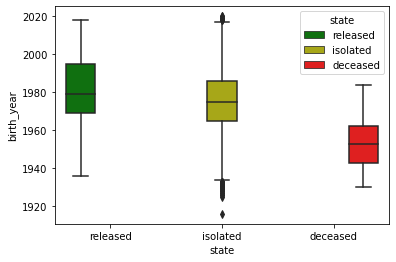

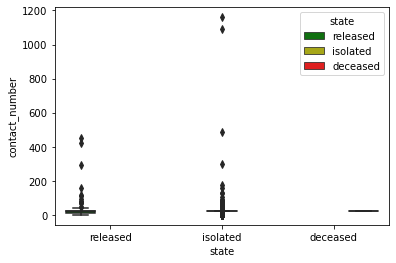

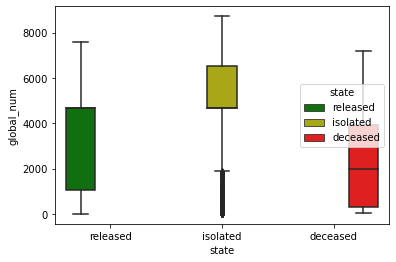

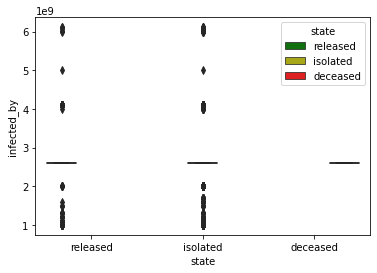

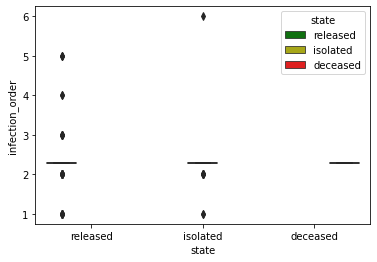

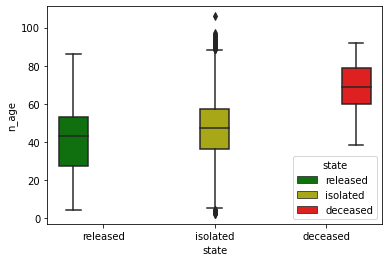

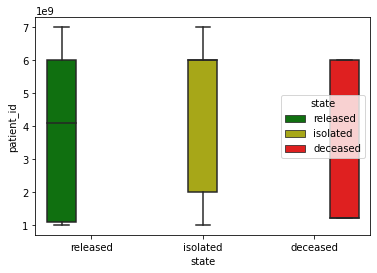

In [193]:
#boxplots but in what view? like in coffee? for 'state' split?? or just the indiv columns
#BY THEMSELVES??

pali = ['g', 'y', 'r']

features_numer=[
 'birth_year',
 'contact_number',
 'global_num',
 'infected_by',
 'infection_order',
 'n_age',
 'patient_id']

for feature in features_numer:
    sns.boxplot(data=df, x='state', y=feature, hue='state', palette=pali)
    plt.show();

In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN!!!!!!! WORKED OUT PERFECTLY!!!! w/ the colors!!!

In [ ]:
#hmmmmmm, so contact_number & infected_by are very weird looking... in addition
#to infection_order but we already knew that one. but former/first 2 have so many
#unique values yet are still strange looking.... like clusters of very close-together
#numbers... let's look closer

In [194]:
df.contact_number.unique()

array([7.50000000e+01, 3.10000000e+01, 1.70000000e+01, 9.00000000e+00,
       2.00000000e+00, 4.30000000e+01, 0.00000000e+00, 6.80000000e+01,
       6.00000000e+00, 2.30000000e+01, 1.17000000e+02, 2.70000000e+01,
       8.00000000e+00, 2.41289538e+01, 1.09100000e+03, 1.31000000e+02,
       1.60000000e+01, 1.40000000e+01, 4.85000000e+02, 4.00000000e+00,
       1.90000000e+01, 2.96000000e+02, 1.50000000e+01, 3.40000000e+01,
       1.00000000e+00, 3.70000000e+01, 2.20000000e+01, 7.00000000e+00,
       1.00000000e+01, 2.80000000e+01, 2.10000000e+01, 3.00000000e+00,
       5.00000000e+00, 2.50000000e+01, 1.80000000e+01, 1.59000000e+02,
       1.10000000e+01, 3.00000000e+01, 4.10000000e+01, 7.10000000e+01,
       3.80000000e+01, 1.30000000e+01, 1.16000000e+03, 4.50000000e+02,
       6.50000000e+01, 1.56000000e+02, 3.90000000e+01, 4.70000000e+01,
       8.60000000e+01, 7.40000000e+01, 1.20000000e+01, 4.60000000e+01,
       6.40000000e+01, 6.60000000e+01, 4.00000000e+01, 4.90000000e+01,
      

In [195]:
#hmmm, okay....
#why is it written in this format when it's only E+2??? lol would be so much simpler
#to NOT write in scientific notation!...
#HOW DO YOU CHANGE THAT??
#>>>OHHH! if you look at the table/df THAT'S HOW IT ACTUALLY IS!!!
#and why are there so many repeats??
#well, we don't know what these even mean...
#oh btw cool, just notice it said you can open/view full results in a text editor!
#################################################################
df.infected_by.unique()


array([2.60078899e+09, 2.00200000e+09, 1.00000000e+09, 1.00000000e+09,
       1.00000002e+09, 1.00000001e+09, 1.00000002e+09, 1.00000002e+09,
       1.00000002e+09, 1.00000002e+09, 1.00000003e+09, 1.00000003e+09,
       1.50000000e+09, 1.00000003e+09, 1.00000004e+09, 1.00000005e+09,
       1.00000006e+09, 2.01700000e+09, 1.00000005e+09, 1.00000007e+09,
       1.00000002e+09, 1.00000011e+09, 1.00000012e+09, 1.00000004e+09,
       1.00000011e+09, 1.00000012e+09, 1.00000011e+09, 1.00000010e+09,
       1.00000013e+09, 1.00000014e+09, 1.00000012e+09, 1.00000013e+09,
       1.00000012e+09, 1.00000016e+09, 1.00000021e+09, 1.00000021e+09,
       1.00000023e+09, 1.00000024e+09, 1.00000025e+09, 1.00000025e+09,
       1.10000001e+09, 1.10000002e+09, 1.10000000e+09, 1.10000003e+09,
       1.10000001e+09, 1.10000003e+09, 1.10000002e+09, 1.10000004e+09,
       1.10000004e+09, 1.10000004e+09, 1.10000006e+09, 1.10000006e+09,
       1.10000000e+09, 1.10000007e+09, 1.10000005e+09, 1.10000008e+09,
      

In [ ]:
#ubbb, these numbers ARE huge,.... but WHY ARE THEY SO HUGE LOLLL!?

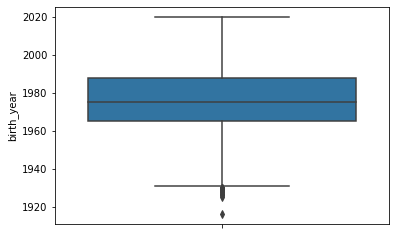

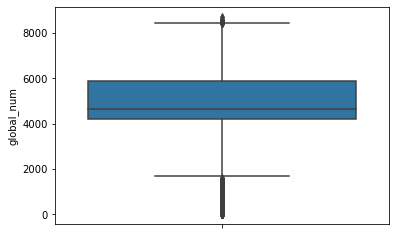

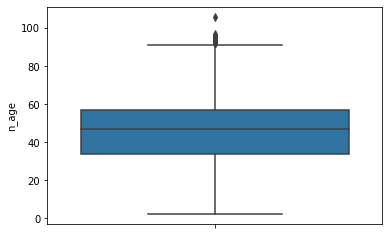

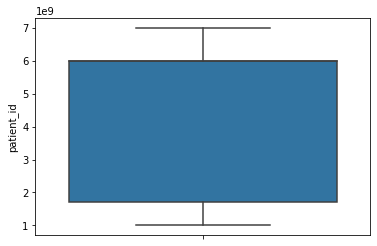

In [196]:
#if they just wanna see the OVERALL pop boxplot for each feature, then:

#lets bin the weirdos this time!
features_numer_trim=[
 'birth_year',
 'global_num',
 'n_age',
 'patient_id']

for feature in features_numer_trim:
    sns.boxplot(data=df, y=feature)
    plt.show();

/Users/deens/miniforge3/envs/tf_m1/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


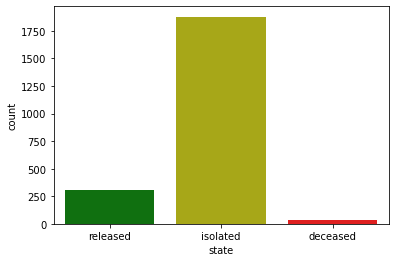

In [198]:
#okay so if we look at this for outliers and then cross-ref w/ the SPLIT-OUT
#boxplots from above, red-green-yellow lights lol, stop/traffic lights,
#btw... looked it up to see what green + red gave you and IT WAS INDEED YELLOW!!!
#we see that it's really only the ISOLATED group that has outliers....
#in high age/old birth year lol aka old age, and low 'global num',... which
#we don't really know what that is....

#let's see what the breakout is of the states!

sns.countplot(df.state,palette=pali);

In [ ]:
#alhamdulillah!!! splendid! good job!
#as i suspected, by far the most were in isolated, hence we see the majority of outliers
#are from that group!

In [280]:
df.state.value_counts(normalize=True)

isolated    0.847160
released    0.138413
deceased    0.014427
Name: state, dtype: float64

**<font color='teal'> Create dummy features for object type features. </font>**

In [202]:
df.infection_case.unique()

array(['overseas inflow', 'contact with patient', 'Seongdong-gu APT',
       'etc', "Eunpyeong St. Mary's Hospital", 'Shincheonji Church',
       'Dongan Church', 'Guro-gu Call Center', 'Onchun Church',
       'Cheongdo Daenam Hospital', 'Suyeong-gu Kindergarten',
       'Ministry of Oceans and Fisheries', 'gym facility in Cheonan',
       'gym facility in Sejong', 'River of Grace Community Church',
       'Pilgrimage to Israel'], dtype=object)

In [200]:
#categorical features, aka ALL VALUES ARE *STRINGS*/TEXT/VERBAL!!!!!!
#technically not necess 'discrete' if like OPEN-ENDED!!!!! LOL! like that's the
#"continuous" version of text/string/verbal!!!!! could be anything! unlimited!!!/infinite
#possibilities!
#########################################################################################
dfo.columns

#these are called "object type!"

Index(['sex', 'age', 'country', 'province', 'city', 'infection_case', 'state'], dtype='object')

In [201]:
#numerical features (includes both continuous and discrete/binary!)
features_numer

['birth_year',
 'contact_number',
 'global_num',
 'infected_by',
 'infection_order',
 'n_age',
 'patient_id']

In [213]:
#we don't need to drop the respy 'state' here right? can keep together and separate
#X & y for training later?
#OH YEAH!!!!!!! SINCE THESE ARE ALL *TEXT/STRING*-BASED/TYPE, WE
#DON'T EVEN HAVE TO SPECIFY THE COLUMNS!!!!!! IT'LL DO OUR WHOLE DFO!!!!
#remem the instructions^ clearly said dummify the OBJECT features, aka strings/text,
#but ARE WE STILL GONNA *USE* THE OTHER FEATURES?!?!?

#the last case study (coffee) had a diff way of doing things

#####################################################################################
#okay so realized after, that since this contains our respy 'state', we should probably
#leave state alone??? cuz fitting/modeling won't work on MULTIPLE columns for respy right!?
#we might even have to convert it to numeric?? tbd
#so for now we'll manually specify the columns

pred_features = ['sex', 'age', 'country', 'province', 'city', 'infection_case']

dummy_dfo2 = pd.get_dummies(dfo,columns=pred_features,drop_first=True)
dummy_dfo2.head()

,state,sex_male,age_100s,age_10s,age_20s,age_30s,age_40s,age_50s,age_60s,age_70s,...,infection_case_Pilgrimage to Israel,infection_case_River of Grace Community Church,infection_case_Seongdong-gu APT,infection_case_Shincheonji Church,infection_case_Suyeong-gu Kindergarten,infection_case_contact with patient,infection_case_etc,infection_case_gym facility in Cheonan,infection_case_gym facility in Sejong,infection_case_overseas inflow
0,released,1,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
1,released,1,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,released,1,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
3,released,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,released,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0


In [ ]:
#SUBHANALLAH WA BI HAMDI, SUBHANALLAHIL 'AUDHEEM!!!!!!
#LAA ILLAHA ILLA ANT, SUBHANAK, INNEE KUNTU MINADH-DHAALIMEEN!!!!!!

#lol pretty disgusting for HUMAN format!!!!!! 180 *COLUMNS*!!!!!!
#lol for the "continuous text/string" ones w/ dozens of results, we include
#all of them except one loll

#first time seeing something of this scale!!!

In [ ]:
#alhamdulillah

In [204]:
df_restore6=df.copy()
dfo_restore=dfo.copy()

### Split the data into test and train subsamples

In [211]:
#LOL wrong thing but NICE USAGE! of str.contains!
#there you go!!!!! this is so we know what to use for the drop next!
#so many column names can't view w/ simple output! middle is hidden! ellipsised/etcetered out! lol
dummy_dfo.columns[dummy_dfo.columns.str.contains('state')]

Index(['state_isolated', 'state_released'], dtype='object')

In [214]:
#make sure state is still there intact!
dummy_dfo2.state.unique()

array(['released', 'isolated', 'deceased'], dtype=object)

In [ ]:
#dropage!

In [215]:
from sklearn.model_selection import train_test_split

# dont forget to define your X and y
#####################################################################################
#soooo wait tho! are we supposed to ONLY use text/string features???
#####################################################################################
X=dummy_dfo2.drop(['state'],axis=1) #original comment lol:#oh! lol forgot, since dummified, not simply called just 'state' anymore!

#####################################################################################
#OH WOW! JUST REALIZED! HOW DOES THAT WORK W/ FITTING IF WE HAVE JUST 1/0'S FOR ALL THESE DUMMIFIED COLUMNS!??!
#####################################################################################

y=dummy_dfo2.state

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, random_state=1)
#lol wow FINALLY someone had some sense to just use random state 1!!!! LOL anwi! 246!

In [ ]:
#####################################################################################
#wait a minute..., so we're PREDICTING state, right? so that means that SHOULDN'T
#be apart of the dummifying!
#and actually.... should it be made into NUMERICAL??? like right now it's text/string/
#categorical. uptil now, we've only seen like predicting 1/0...
#well, maybe the least we can do is just LEAVE state alone and NOT dummify it??

### Scale data to prep for model creation

In [216]:
#scale data
import numpy as np
# from sklearn import preprocessing
#gonna use MY guy instead! ;P
#in our training in DataCamp we did:
from sklearn.preprocessing import StandardScaler

# build scaler based on training data and apply it to test data to then also scale the test data

#ummmm what's diff b/w 'apply scaler' to test data and then 'scale' the test data???
#####################################################################################

# scaler = StandardScaler().fit(X_train)
# X_train_scaled=scaler.transform(X_train)
# X_test_scaled=scaler.transform(X_test)

#also gonna do ^this my way! datacamp way:

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
#so at first, at quick look i was like oh yeah! they're simply doing the same thing!
#so only TRAIN ofc is getting FIT,
#and so that doesn't apply to TEST; so we/DataCamp way was to use fit_transform on
#train and JUST plain transform on test; but.... then i realized like.... wait...
#they first fit train, then plain transformed it the same for BOTH train & test!?!?!?!
#whereas datacamp way was to ONLY fit it for TRAIN and only transform it for TEST!?!
#so they DON'T do the same thing?!?!?!?!
#>>BUT THEN WHEN YOU TRY BOTH IT TURNS OUT THEY *DO* GIVE THE EXACT SAME RESULTS?!?!
#how is that?!?!?!?
#####################################################################################
#####################################################################################
#but anyway, this oughta have to do w/ what they were saying about build scaler
#on test then 'use it' to transform/scale test?

#anyway... we'll proceed w/ my way... guess we'll find out if this was right or not???
#or maybe not loll!
#>>TURNS OUT TO INDEED BE EXACT SAME THING!!


In [217]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.linear_model import LogisticRegression
from matplotlib import pyplot
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,roc_auc_score
from sklearn.metrics import accuracy_score,log_loss
from matplotlib import pyplot

### Fit Random Forest Classifier
The fit model shows an overall accuracy of 80% which is great and indicates our model was effectively able to identify the status of a patients in the South Korea dataset.

In [ ]:
#man why they SPOILING IT ahead of time!? lol
#made me think i was supposed to get this on my own in / from the last code block!

In [218]:
from sklearn.ensemble import RandomForestClassifier

#classifier
clf = RandomForestClassifier(n_estimators=300, random_state = 1,n_jobs=-1)
#NO MAX DEPTH?? well, maybe it's cuz we ALREADY limited the features it's using???
#####################################################################################
#note, 'n_jobs' is 'number of 'jobs' to run in parallel, meaning like processes?
#confusing what it's saying - like makes it seem like fit,predict and more it mentions
#are all run in parallel by default? but then it says default is 'None',...and that
#'None' means *1*!!!!! lol, ANNOYING. and then it says "-1" means using ALL PROCESS*ORS*!?!
#from the docs! docstring lol :P
#"n_jobsint, default=None
#The number of jobs to run in parallel. fit, predict, decision_path and apply are all
#parallelized over the trees. None means 1 unless in a joblib.parallel_backend context.
#-1 means using all processors. See Glossary for more details.""
#####################################################################################

#so we already fit above w/ the scale/transforming... we needa fit again?
#i remem this was really confusing in DataCamp, the most confusing part for me,
#that i don't think i ever got a clear answer on...
#but yeah i think there we did also do another fit / like this is separate...
#the 'scaling'/transforming fit is something else
#i think before it looked different cuz it wasn't fair, they were throwing WAY too much
#at us at once, rushing/shoving/cramming at the end! scaling/imputing/pipelining lol piping/
#kFold/crossval / multiple models iteration etc etc! so couldn't differentiate / appreciate
#what was what! so had we looked at an INDIVIDUAL model, i guess woulda been like this!
#aka felt more familiar!

#fit
model_res = clf.fit(X_train_scaled, y_train)

#predict
y_pred = model_res.predict(X_test_scaled)

#prediction PROBABILITIES, like for EACH OF THE TARGET FEATURE CLASSES/LABELS!!! response
#but isn't it only supposed to give it to you for ONE?!? like what we saw in BINARY!? 0/1,
#only gave you the prob of/for *1*!!!
#OH, well i guess it COULD still just give us the probability for ONE of the classes...
#BUT HOW WOULD WE KNOW WHICH ONE??
#>>>OHHHHHH!!!!!! SUBHANALLAH WA BI HAMDI, SUBHANALLAHIL 'AUDHEEM!!!!!!
#aH figured it out by looking ahead at the next line!
#so the reason they printed it out as/for just ':,1' is to get the probs for ONE
#of the 3 classes!!!!!! that's ISOLATED, right, don't know why that one.. but that
#is the middle one so maybe that's why lol
#but anyway, IF YOU REMOVE THAT YOU CAN SEE *ALL THREE* PROBS!!!!!! BELOW! JUST LIKE
#WE DREAMED OF!!!!!!
#AND THAT MEANS WE DIDN'T EVEN HAVE TO CONVERT THE TEXT STRINGS OF THE TARGET FEATURE
#TO NUMBERS!!!! and our first time seeing more than 2/binary classification!!!!!!
y_pred_prob = model_res.predict_proba(X_test_scaled)
#####################################################################################


In [220]:
y_pred_prob

array([[0.        , 1.        , 0.        ],
       [0.        , 1.        , 0.        ],
       [0.        , 1.        , 0.        ],
       ...,
       [0.        , 0.50651287, 0.49348713],
       [0.        , 0.99333333, 0.00666667],
       [0.03856891, 0.96143109, 0.        ]])

In [219]:
y_pred_prob[:,1]

array([1.        , 1.        , 1.        , 0.75562765, 0.85709297,
       0.90333333, 1.        , 0.75583333, 1.        , 1.        ,
       1.        , 0.65493767, 0.88039757, 1.        , 0.90042914,
       0.64388889, 0.14166667, 0.90042914, 0.85709297, 0.95923077,
       0.85709297, 0.78077778, 0.75562765, 0.99615313, 0.94579255,
       1.        , 0.75562765, 1.        , 0.6619127 , 0.99479399,
       1.        , 1.        , 0.83083333, 1.        , 0.99666667,
       1.        , 0.99381195, 0.81972222, 0.63564276, 0.85709297,
       0.75562765, 0.55592063, 0.99333333, 1.        , 0.75562765,
       1.        , 0.61528968, 0.96143109, 0.53966667, 0.90991919,
       0.91630179, 0.99333333, 0.85709297, 1.        , 1.        ,
       1.        , 0.74575132, 1.        , 0.75562765, 0.98666667,
       1.        , 0.90042914, 0.75562765, 1.        , 0.86134638,
       0.04375   , 1.        , 0.65074471, 1.        , 0.75562765,
       0.94715873, 1.        , 0.99333333, 0.80027778, 1.     

In [285]:
clf.classes_
#okay! this confirms the middle is still ISOLATED! but actually,...
#did it flip the other 2?!

array(['deceased', 'isolated', 'released'], dtype=object)

In [221]:
#OH! let's see the actual predictions! wonder what these'll look like!? text strings?!
y_pred

array(['isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'released', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolated',
       'deceased', 'isolated', 'isolated', 'isolated', 'isolated',
       'isolated', 'isolated', 'isolated', 'isolated', 'isolat

/Users/deens/miniforge3/envs/tf_m1/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

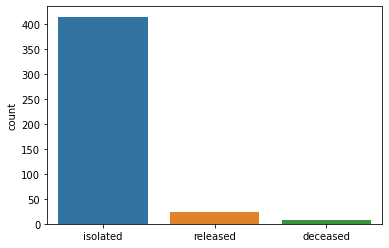

In [224]:
#DROOOOOOOOOOOOOOOOOOOOPE!!!!!! subhanallah wa bi hamdi, subhanallahil 'audheem!!!!!
#lol it seems like ALL isolated, but if you look close, a few sprinkled deceased &
#released;... but wonder if it's overwhelmingly isolated simply because THAT WAS THE
#MAJORITY OF / MOST POPULOUS CLASS/STATE!?!? what was that term? class imbalance!

#in fact, let's see; let's see if predictions breakouts are similar to overall!

sns.countplot(y_pred);

In [ ]:
#seems even MORE overwhelmingly isolated!!! lol too much isolation no good for person!

In [225]:
# y_pred.value_counts(normalized=True)
#oh yeah lol can't do on numpy array.... equivalent?
#####################################################################################

AttributeError: 'numpy.ndarray' object has no attribute 'value_counts'

In [279]:
np.unique(y_pred,return_counts=True)


(array(['deceased', 'isolated', 'released'], dtype=object),
 array([  7, 414,  23]))

In [283]:
np.unique(y_pred,return_counts=True)[1] / len(y_pred)

array([0.02, 0.93, 0.05])

In [281]:
df.state.value_counts(normalize=True)

isolated    0.847160
released    0.138413
deceased    0.014427
Name: state, dtype: float64

In [ ]:
#okay! so you can see that yeah we did get a higher proportion of isolated
#here, but it was already high; so things across the board are relatively still
#in the same ballpark!
#and as we see next, THINGS TURNED QUITE GOOD!!! so even though there was
#massive class imbalance, we didn't have to do any over/undersampling or other
#techniques to correct! maybe those would've helped tho!

In [226]:
#####################################################################################
#what's 'lr'??? if '1', that's 2nd one, of 3, so middle, which is ISOLATED!!!
lr_probs = y_pred_prob[:,1]

ac = accuracy_score(y_test, y_pred)

f1 = f1_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print('Random Forest: Accuracy=%.3f' % (ac))

print('Random Forest: f1-score=%.3f' % (f1))

Random Forest: Accuracy=0.824
Random Forest: f1-score=0.789


In [ ]:
#WHOAAAAA SUBHANALLAH REALLY?!?!?!?!?
#thought i messed up big time but they said accuracy of 80% and this is even better!!!
#so then yeah it's true that we DIDN'T NEED TO DO ON NUMERICAL FEATURES?!?!

#well, let's try it WITH just to see!

#OHHH! but also - we're not sure if it woulda made a difference if i did
#the .transform/fit thing THEIR WAY!? we'll try that after!

##########################################################################################

In [227]:
df.columns

Index(['patient_id', 'global_num', 'sex', 'birth_year', 'age', 'country',
       'province', 'city', 'disease', 'infection_case', 'infection_order',
       'infected_by', 'contact_number', 'state', 'n_age'],
      dtype='object')

In [228]:

#but i think obviously we'll remove the USELESS features for predicting
#like PATIENT ID!!! etc

#okay so let's first trim down the original df!

#pred_features = ['sex', 'age', 'country', 'province', 'city', 'infection_case']

#features_numer = ['birth_year',
#  'contact_number',
#  'global_num',
#  'infected_by',
#  'infection_order',
#  'n_age',
#  'patient_id']

# all_features = ['patient_id', 'global_num', 'sex', 'birth_year', 'age', 'country',
#        'province', 'city', 'disease', 'infection_case', 'infection_order',
#        'infected_by', 'contact_number', 'state', 'n_age']


#some of these are iffy... like infection_order, contact_number, infected_by esp!
#don't know what global_num is... so yeah we'll bin these 4!

#loll, just realized... how are there 4 diff countries if this is JUST S. Korea??
#i guess visitors...
#could prob throw out tho...but maybe not so fast.. could reveal something interesting...
#like CHAINER! (china lol)

#lol 'features kreepers!'
keepers = [ 'sex', 'birth_year', 'age', 'country', 'province', 'city', 'disease', 'infection_case', 'state', 'n_age']

df_trim = df[keepers]
#will still dummify same ones... only thing is, disease is binary/cat... so are we
#supposed to convert that to text?? or just leave that as is??
####################################################################################

dummy_all = pd.get_dummies(df_trim,columns=pred_features,drop_first=True)

X=dummy_all.drop(['state'],axis=1)
y=dummy_all.state
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, random_state=1)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

model_res = clf.fit(X_train_scaled, y_train)

y_pred = model_res.predict(X_test_scaled)

lr_probs = y_pred_prob[:,1]

ac = accuracy_score(y_test, y_pred)

f1 = f1_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print('Random Forest: Accuracy=%.3f' % (ac))

print('Random Forest: f1-score=%.3f' % (f1))


Random Forest: Accuracy=0.829
Random Forest: f1-score=0.787


In [229]:
#okay pretty much the same!!!

#wonder what deal is about if we needed to convert disease to yes / no text from
#binary/numerical!!!

#let's see if there's any diff for using THEIR way of fit/transform scaling!
#let's go back to original! (lol actually didn't mean to, wanted to try it on here
#first, the 'rough' one, in case i messed up or something, but ended up making it
#for original anyway, BUT AH IT WORKED!!!)

X=dummy_dfo2.drop(['state'],axis=1)
y=dummy_dfo2.state
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, random_state=1)

# X_train_scaled = scaler.fit_transform(X_train)
# X_test_scaled = scaler.transform(X_test)
#try THEIR way instead!
scaler = StandardScaler().fit(X_train)
X_train_scaled=scaler.transform(X_train)
X_test_scaled=scaler.transform(X_test)

model_res = clf.fit(X_train_scaled, y_train)

y_pred = model_res.predict(X_test_scaled)

lr_probs = y_pred_prob[:,1]

ac = accuracy_score(y_test, y_pred)

f1 = f1_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print('Random Forest: Accuracy=%.3f' % (ac))

print('Random Forest: f1-score=%.3f' % (f1))


Random Forest: Accuracy=0.824
Random Forest: f1-score=0.789


In [ ]:
#SUBHANALLAH WA BI HAMDI, SUBHANALLAHIL 'AUDHEEM!!!!! EXACTLY THE SAME!!!!!

#BUT WAIT! REMEM IT SEEMED LIKE THEY WERE ACTUALLY DOING SOMETHING
#*DIFFERENT*!!!!!! so i guess they WEREN'T different/WERE the same?!?

##############################################################################

### Create Confusion Matrix Plots
Confusion matrices are great ways to review your model performance for a multi-class classification problem. Being able to identify which class the misclassified observations end up in is a great way to determine if you need to build additional features to improve your overall model. In the example below we plot a regular counts confusion matrix as well as a weighted percent confusion matrix. The percent confusion matrix is particulary helpful when you have unbalanced class sizes.

In [ ]:
#interesting! didn't know there was a PERCENTS confusion matrix! but yeah, makes sense
#that we'd wanna have a closer look like that at proportions for class imbalance,
#like fraud stuff, so we don't get misled!/lol we don't get FRAUDED about FRAUD!!!

In [288]:
# class_names=['isolated','released','missing','deceased'] # name  of classes
#wait wait wait..... what the higgy siggy??? WE NEVER HAD NO *MISSINGS*!??!?!!?!??!!??!
########################################################################################

#LET'S TRY *CORRECTING* AND SEE IF THAT CHANGES THINGS/MAKES IT RIGHT!!
#class_names=['isolated','released','deceased']

#OHHHH WAIT A MINUTE!!!!!!
#I THINK WE GOTTA *MATCH* THIS TO THE ORDER IT'S IN!!!!!
#LOOK THIS IS *ALSO THE WRONG ORDER*!!!!!!
#IT'S ACTUALLY:
#class_names=['deceased','isolated','released'] (according to .classes_, & unique! even tho originally for df plot deceased & released were switched! but that's irrelevant now!!)
#BUT WHY RISK IT!?!??!!?!? DON'T TEST YOURSELF!! LOL!
#THIS IS WHY THE CONFUSION MATRIX DIDN'T LINE UP RIGHT BELOW THE WAY THEY HAD IT!!!!!!
#CUZ HAD THE WRONG ORDER!!!!!! I WAS WONDERING HOW DOES 'ISOLATED' NOT HAVE
#THE BIG NUMBERS/HAVE SUCH SMALL NUMBERS WHEN CLEARLY LIKE *EVERYTHING* WAS
#ISOLATED, BOTH IN ACTUALITY AND PREDICTIONS!!!!!!! AND OTHERS WERE SO SMALL
#IN BOTH SO DEF CAN'T BE EITHER OF THEM 2 GETTING THEM BIG NUMBERS! #AH YOU CHECKED!
#LOL SHAME ON THEM FOR SO MUCH LACK OF PROOFREADING!!!!! WHAT KIND OF DATA SCIENTISTS ARE THESE?!?!
#husnal dhann i guess. if we forgive others/cover up for others' faults, Allah will insha'Allah forgive us / cover up our faults! :D
#JUST DO!:
class_names = clf.classes_
#TO BE SAFE!!!!!!!! NO CHANCES!!!!!!

Confusion matrix, without normalization
[[  4   3   0]
 [  3 352  13]
 [  0  59  10]]
Normalized confusion matrix
[[0.57 0.43 0.  ]
 [0.01 0.96 0.04]
 [0.   0.86 0.14]]


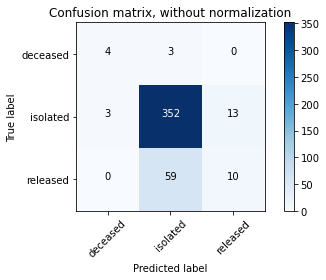

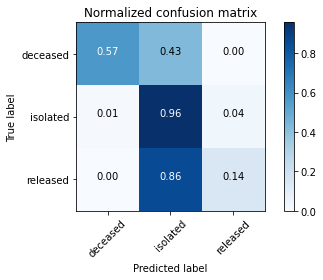

In [289]:
################################################################################
import itertools
import numpy as np
import matplotlib.pyplot as plt

from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()


# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=class_names,
                      title='Confusion matrix, without normalization')
#plt.savefig('figures/RF_cm_multi_class.png')

# Plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=class_names, normalize=True,
                      title='Normalized confusion matrix')
#plt.savefig('figures/RF_cm_proportion_multi_class.png', bbox_inches="tight")
plt.show()

In [ ]:
####################################################################################
#HOLY GUACAMOLE! alot to process here!!
    #first of all, THEY NEVER USE THE CONFUSIONMATRIXDISPLAY() TOOL!!!!!! did it like organically?! but why go thru all that work?!?!!?
    #WE'VE NEVER SEEN A CONFUSION MATRIX WITH MORE THAN 2 CLASSES!!!!! ONLY HAVE SEEN BINARY!!!!
        #SO HOW WOULD LIKE TRUE POSITIVES/ETC WORK!?!!??!?
    #how are the percentages calculated?? ohhh ACROSS-WAYS you can tell! each row adds to 1!
    #THESE FRIGGIN GUYS!!!!!! so dumbos put FOUR classes when there's only 3,
        #and it shows that we're right cuz the fourth one is completely blank!
        #BUT WHAT'S REALLY ANNOYING IS THAT THE FOURTH ONE IS *DECEASED* WHICH *IS*
        #A VALID CATEGORY!!!!! BUT THEY DUMBOS PUT IT *LAST*!!! BUMPING IT OUT!!!!
        #my guess is maybe they wanted to be more 'politically correct' or something?
        #or they were referencing a diff dataset and not this one? but there was no
        #'missing' category/option!!!!!!

####################################################################################

In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN!!! NOW IT'S RIGHT!!!

### Plot feature importances
The random forest algorithm can be used as a regression or classification model. In either case it tends to be a bit of a black box, where understanding what's happening under the hood can be difficult. Plotting the feature importances is one way that you can gain a perspective on which features are driving the model predictions.

In [ ]:
#yes that would be great to know! esp w/ random forest since WE CAN'T JUST LOOK AT
#ALL THE TREES IN THE FOREST!!!

30


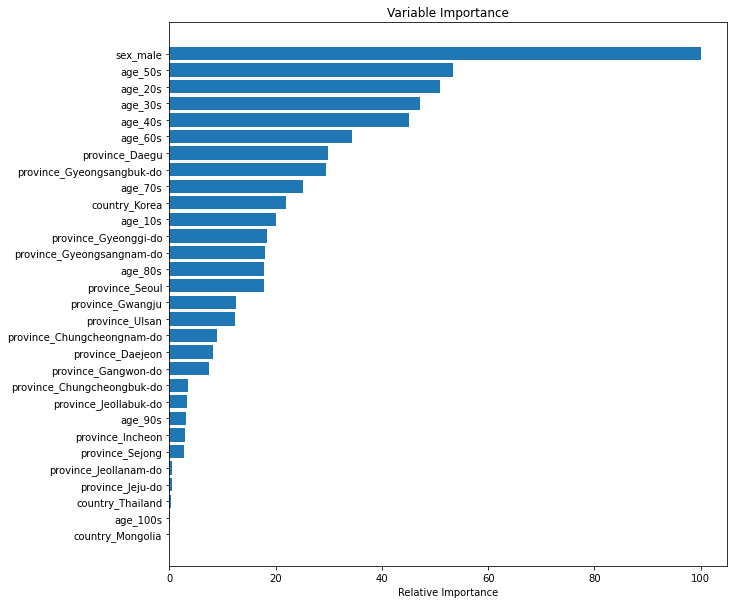

In [240]:
#####################################################################################
#okay cool so it's like a built-in method/feature!
feature_importance = clf.feature_importances_

# make importances relative to max importance
#what's this '30' business?? did they mean 300 since we had that many trees/classifiers/
#"estimators"? but no that wouldn't make sense to subset then! so maybe just wanna
#do the first 30 trees?? are they like ranked somehow??
#can't ofc be FEATURES are they?? cuz only had like 7 or so/mething! #OHHHH WAIT!
#SINCE WE MELTED/DUMMIFIED, WE ACTUALLY *DID* HAVE LIKE 100+ FEATURES!!!!!!
#so would this only be the top 30 of them?? i'd imagine so, since feature_importance
#is obvy gonna like score/rank them!
#####################################################################################

feature_importance = 100.0 * (feature_importance / feature_importance.max())[:30]
sorted_idx = np.argsort(feature_importance)[:30]

pos = np.arange(sorted_idx.shape[0]) + .5
print(pos.size)
sorted_idx.size
plt.figure(figsize=(10,10))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.show()
#####################################################################################

In [246]:
#SUBHANALLAH WA BI HAMDI SUBHANALLAHIL 'AUDHEEM!!!!!!!!!!!
#biggest thing is being a guy!!!!!!
#but the thing is.... WHICH IS THAT MOST TIED TO?! or is it tied to like all of 'em..necessarily...
#like is it being a guy was most closely affiliated with a CERTAIN state and not others??
##########################################################################################
#WELL LET'S JUST SEE ABOUT THAT!

df.groupby('sex')['state'].value_counts(normalize=True)

sex     state   
female  isolated    0.860942
        released    0.131459
        deceased    0.007599
male    isolated    0.827051
        released    0.148559
        deceased    0.024390
Name: state, dtype: float64

In [247]:
#hmmm doesn't really stand out? let's try switching
df.groupby('state')['sex'].value_counts(normalize=True)

state     sex   
deceased  male      0.687500
          female    0.312500
isolated  female    0.602980
          male      0.397020
released  female    0.563518
          male      0.436482
Name: sex, dtype: float64

In [ ]:
#####################################################################################
#OHHHHH I SEE! overwhelmingly the ones who died were MALES!!!!
#but then also pretty big majority of ISOLATEDS were female?
#SO DID IT LIKE ONLY GIVE US FEATURE IMPORTANCE IN TERMS OF TIED-TO/LINKS TO *DEATH*???
#LIKE WAS THAT THE 'TARGET' CLASS OF INTEREST?? BUT i looked at the code and
#IT DIDN'T SEEM TO EVER SPECIFY THAT?? OR IS IT AUTOMATIC?? LIKE DEFAULTS TO THE
#*LAST* ONE?? of the three, aka deceased?
#AND SINCE THERE'S ONLY TWO GENDER CHOICES, DOESN'T THAT MEAN WOMEN
#WOULD JUST BE THE COMPLEMENT AND SO BE LIKE EQUALLY CORRELATED??
#so like if it references one binary choice, it's like automatically referencing the
#OTHER could you say?? or talking about the WHOLE feature really!?!?
#####################################################################################

In [233]:
#let's get an idea of under the hood for ourselves!!!
clf.feature_importances_

array([7.68e-02, 6.95e-05, 1.54e-02, 3.92e-02, 3.63e-02, 3.47e-02,
       4.10e-02, 2.65e-02, 1.93e-02, 1.37e-02, 2.43e-03, 1.69e-02,
       0.00e+00, 2.03e-04, 2.71e-03, 6.95e-03, 2.29e-02, 6.25e-03,
       5.77e-03, 9.71e-03, 1.41e-02, 2.26e-02, 1.38e-02, 2.33e-03,
       4.29e-04, 2.53e-03, 4.40e-04, 2.11e-03, 1.36e-02, 9.46e-03,
       9.96e-05, 9.12e-06, 2.36e-03, 8.60e-04, 1.30e-03, 4.01e-03,
       1.76e-03, 3.46e-04, 4.42e-03, 2.04e-03, 6.52e-03, 9.84e-03,
       7.28e-03, 2.44e-03, 1.93e-05, 9.75e-03, 2.31e-04, 1.19e-04,
       6.63e-04, 4.64e-04, 4.04e-04, 8.41e-05, 3.98e-04, 3.76e-03,
       3.49e-03, 1.98e-03, 1.26e-02, 7.63e-05, 3.28e-03, 1.69e-03,
       4.48e-03, 1.21e-02, 5.35e-03, 5.92e-03, 4.00e-03, 2.50e-03,
       1.00e-03, 3.75e-03, 9.85e-04, 4.05e-03, 0.00e+00, 3.84e-04,
       6.08e-04, 9.36e-05, 1.87e-03, 1.93e-03, 2.77e-03, 1.13e-04,
       2.03e-03, 2.33e-04, 3.08e-03, 3.29e-03, 1.72e-04, 3.65e-03,
       7.53e-04, 6.97e-05, 2.95e-03, 1.12e-04, 9.24e-03, 2.14e

In [234]:
#ahhh okay, makes sense now! don't know what these numbers mean though?
#unless...
np.sum(clf.feature_importances_)

1.0

In [235]:
#SUBHANLLAH WA BI HAMDI, SUBHANALLAHIL 'AUDHEEM!!!!!! THERE IT IS!!!!!!
#it's like giving a CHUNK/PIECE OF THE PIE of the sphere of influence / share / CUTT
#FOR EACH FEATURE!!!

len(clf.feature_importances_)
################################################################################

178

In [236]:
dummy_dfo2.shape

(2218, 179)

In [ ]:
#ALHAMDULILLAHI RABBIL 'AALAMEEN!!!!!! THAT'S WHY!!!!!
#179 TOTAL COLUMNS, W/ 1 BEING THE TARGET/RESPY, THUS 178 *FEATURES*!!!!!!!!!!!!!

In [290]:
np.argsort(clf.feature_importances_)#.sort_values() >> #ohh right, no sort_values w/ np!
#and don't need the 100 here cuz WON'T CHANGE THE RELATIVE RANKINGS!

#argsort gives the INDEX of the value if were sorted LOW TO HIGH!?
#BUT THEN WHY CAN'T IT JUST GIVE US THE DANG VALUES LOLLLL!? like a simple
#sort_values!?!?!?!?
########################################################################

array([162, 146,  70, 101, 154, 112, 157,  12,  94,  31,  44, 151, 176,
       111, 109, 117, 115,   1,  85,  57,  51,  91, 106,  73,  30,  87,
        77,  47, 153,  96,  82, 143, 129, 116,  13,  90,  46,  79, 141,
       137, 169, 113, 136,  37,  71,  52,  50, 156,  99,  24,  26,  49,
       130,  93,  72, 159,  48,  84, 122,  33, 133,  97,  68, 132,  66,
       166, 142,  34, 119, 145, 158, 144,  59, 172,  36, 124, 118,  74,
       107,  75,  55, 149,  78,  39, 163, 170,  27,  98,  23,  32, 127,
       121,  10,  43, 148, 152,  65,  25, 105, 147,  14,  76, 104, 155,
        86, 168,  80, 120, 131, 100,  58,  81, 175, 102,  54, 140,  83,
        67,  53, 160,  64,  35,  69, 123,  38,  60, 126,  62, 150, 128,
        18,  63,  95,  17, 108, 134,  40, 114, 125,  15,  42, 110, 164,
       161, 138,  88,  29,  19,  45,  41, 167,  61, 139,  56, 165,  92,
        28,   9,  22,  20, 171, 177,   2,  11,   8,  89, 174,  21, 135,
        16,   7, 173,   5, 103,   4,   3,   6,   0])

In [ ]:
#too good to be true?? the very HIGHEST is the very FIRST feature tried!?

In [291]:
#i stand corrected, HERE’S HOW TO SEE THE ACTUAL SORTED VALUES!!!
#just like w/ df’s, reference the indexes!!!!:
clf.feature_importances_[np.argsort(clf.feature_importances_)]

array([0.00e+00, 0.00e+00, 0.00e+00, 0.00e+00, 0.00e+00, 0.00e+00,
       0.00e+00, 0.00e+00, 2.18e-06, 9.12e-06, 1.93e-05, 2.14e-05,
       4.25e-05, 5.57e-05, 5.79e-05, 5.84e-05, 6.59e-05, 6.95e-05,
       6.97e-05, 7.63e-05, 8.41e-05, 8.62e-05, 8.90e-05, 9.36e-05,
       9.96e-05, 1.12e-04, 1.13e-04, 1.19e-04, 1.20e-04, 1.50e-04,
       1.72e-04, 1.86e-04, 1.97e-04, 2.00e-04, 2.03e-04, 2.18e-04,
       2.31e-04, 2.33e-04, 2.35e-04, 2.55e-04, 2.57e-04, 2.66e-04,
       2.87e-04, 3.46e-04, 3.84e-04, 3.98e-04, 4.04e-04, 4.19e-04,
       4.20e-04, 4.29e-04, 4.40e-04, 4.64e-04, 5.65e-04, 5.96e-04,
       6.08e-04, 6.41e-04, 6.63e-04, 7.53e-04, 8.01e-04, 8.60e-04,
       8.79e-04, 9.17e-04, 9.85e-04, 9.94e-04, 1.00e-03, 1.05e-03,
       1.18e-03, 1.30e-03, 1.33e-03, 1.49e-03, 1.59e-03, 1.63e-03,
       1.69e-03, 1.70e-03, 1.76e-03, 1.83e-03, 1.83e-03, 1.87e-03,
       1.91e-03, 1.93e-03, 1.98e-03, 2.01e-03, 2.03e-03, 2.04e-03,
       2.05e-03, 2.08e-03, 2.11e-03, 2.27e-03, 2.33e-03, 2.36e

In [ ]:
######################################################################################################
#SO CONFIRMED!!!!!! IT *DOES* RANK LOW TO HIGH!!!!! BUT THEN HOW DID IT
#DISPLAY AS HIGH TO LOW???

In [ ]:
#OHH AND *NOTE*!!! it's dividing each's weight by the MAX weight as like a type
#of normalization?! ohh, i guess it's like they say, makes it RELATIVE importance?!
#but if they all sum up to 1,... isn't it like ALREADY relative importance??
######################################################################################################

In [265]:
#LET'S JUST SEE *ONE* EXAMPLE OF/ONE OF ITS TREES TO SEE IF INDEED
#THESE MOST PRIZED FEATURES ARE USED!
#oh but, depends on HOW MANY of the features it chooses from ofc!!!
import graphviz
# from sklearn.tree import export_graphviz
from sklearn import tree

#THIS BORROWS FROM HOW THEY DID IT IN THE BEGINNING!
#NAMELY: USING THIS FIRST THING OF 'ESTIMATORS' aka specifying WHICH TREE
#OF THE FOREST WE WANNA DISPLAY! only seems to let us do one at a time!

#AND THE OTHER MAJOR THING IS *RESIZING*!!!!!!
#WITHOUT THE FIRST PART OF ESTIMATORS, IT'LL SAY THAT RANDOMFORESTCLASSIFIER
#HAS NO WHATEVER 'TREE_' AND WE WERE SCRATCHING OUR HEADS LIKE...
#WE NEVER SAID IT DID! BUT I THINK WHAT IT MEANT WAS MORE LIKE,
#*WE DIDN'T SPECIFY ITS ARG OF 'TREE_'!!!!! and from a quick lookup,
#it seems like this had to do w/ the 'estimators' thing right below that they did!!!
#smart them! maybe cuz estimators ARE trees?!?
#and then if you don't do the whole resize thing, which requires you to save as an
#outfile, IT'LL BE GIGANTIC HUMONGOUS!!!!!
#upside to saving/outputting as a png is draggability, but downside is VISIBILITY,
#.... ESPEC for something this ithaneey HAIY-UUUUGE!

clf_estim = clf.estimators_[1]
# coronatree = 
export_graphviz(clf_estim, out_file='tree.dot', 
                     feature_names=X.columns,  
                     class_names=y.unique(),#>>OR entr_model.classes_!!!! gives exact same thing! #or 'target_names', like iris has? or is that only specific to it?? since that's like a 'special' 'example' package??
                     filled=True, rounded=True,
                     special_characters=True)
# graph = graphviz.Source(coronatree)

from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# graph
from IPython.display import Image
Image(filename = 'tree.png')

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.344673 to fit


In [ ]:
#HOOLLLLLYYYYYY GUAACCAAAMOOLLLLLEEEEEE!!!!!!!! IS THAT REAL!?!?
#man subhanAllah! just like the inordinately big COSMOS!!!!! GLORY BE TO ALLAH!
#THE CREATOR OF THE HEAVENS AND THE EARTH!!!!!
#if the galaxies are so great,... IMAGINE THE HEAVENS!!!!!! THEY HAVEN'T EVEN
#STARTED YET!!!!!!

In [ ]:
############################################################################
#now that we know how to view multiple trees in the forest, we could check them out
#to see if the TOP FEATURES are really regularly used to split on!

#and seems like for this, converting to png may not be very useful cuz then makes
#TOO small!!! maybe just keep as raw, and JUST LOOK AT THE TOP LEVELS!!!
#or at least don't make AS small a png!

############################################################################

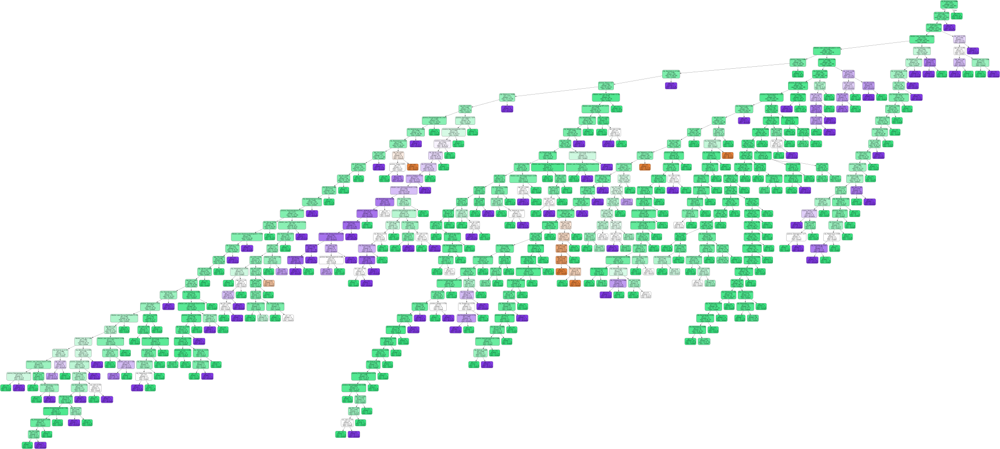

In [293]:
#let's see if we can look at the RAW graphic, uncompressed of a couple?

clf_estim = clf.estimators_[1]
coronatree = export_graphviz(clf_estim, out_file=None, 
                     feature_names=X.columns,  
                     class_names=y.unique(),#>>OR entr_model.classes_!!!! gives exact same thing! #or 'target_names', like iris has? or is that only specific to it?? since that's like a 'special' 'example' package??
                     filled=True, rounded=True,
                     special_characters=True)
graph = graphviz.Source(coronatree)
graph

In [ ]:
#ohhhh okay... interesting. well, got it to work, but seems kinda random?
#well, i guess that's the point! maybe sex wasn't one of the choices for first split!
#but you DO see it a couple levels down!!
#but confusing... cuz remem, now EVERY feature is dummied, meaning EVERY feature
#is BINARY!!! so.... shouldn't it only be checking if something EQUALS/*IS* 1 OR 0???
#SO THEN WHY DOES IT HAVE RANDOM DECIMAL/FLOAT NUMBERS!!!!!?????? AND NOT EVEN
#BETWEEN 0&1 BUT *BEYOND*?!?!?!!? in fact, since the output/legs/branches/children
#are TRUE/FALSE, IT DOESN'T EVEN NEED TO COMPARE TO ANYTHING!!! THE TWO LEGS *ARE*
#THE CHOICES RIGHT!?!? 1/0!!!!!!

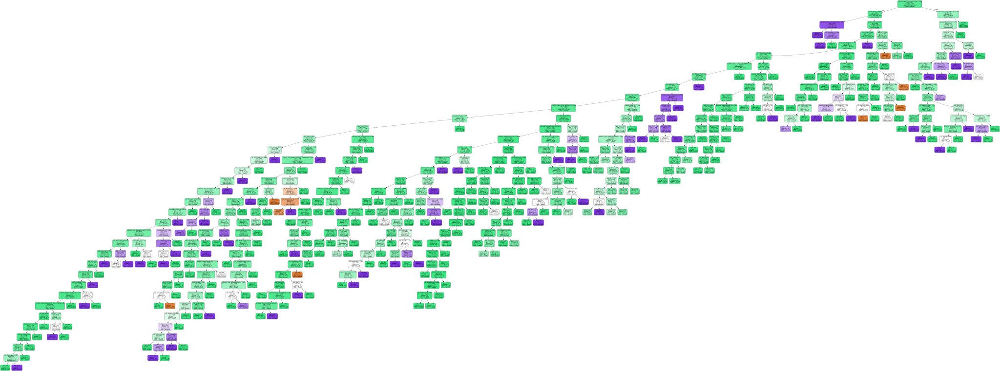

In [295]:
#let's try one more!
clf_estim = clf.estimators_[5]
coronatree2 = export_graphviz(clf_estim, out_file=None, 
                     feature_names=X.columns,  
                     class_names=y.unique(),#>>OR entr_model.classes_!!!! gives exact same thing! #or 'target_names', like iris has? or is that only specific to it?? since that's like a 'special' 'example' package??
                     filled=True, rounded=True,
                     special_characters=True)
graph2 = graphviz.Source(coronatree2)
graph2

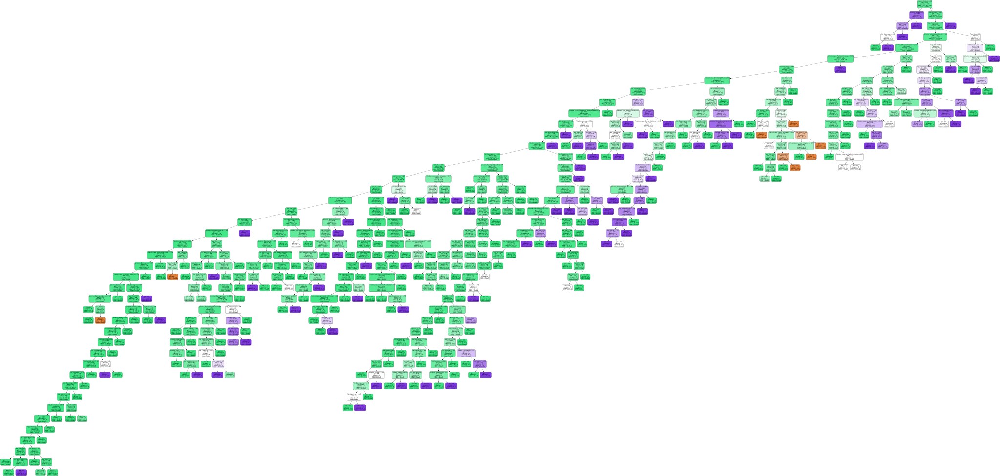

In [298]:
#let's try one more! till we get something different!
clf_estim = clf.estimators_[0]
coronatree3 = export_graphviz(clf_estim, out_file=None, 
                     feature_names=X.columns,  
                     class_names=y.unique(),#>>OR entr_model.classes_!!!! gives exact same thing! #or 'target_names', like iris has? or is that only specific to it?? since that's like a 'special' 'example' package??
                     filled=True, rounded=True,
                     special_characters=True)
graph3 = graphviz.Source(coronatree3)
graph3

In [ ]:
#very interesting! tried a few (not all, about half) but NONE had sex as the first
#splitter! surprisingly ALOT had a CITY as the first!!! EVEN THOUGH *NONE* OF THE
#TOP 30 ARE ABOUT CITY!!!!! sA i guess that's the whole beauty of Random Forest!!!
#IT REALLY IS REALLY REALLY RANDOM!!! THE STRONG FEATURES STILL FIND A WAY TO
#PREVAIL EVENTUALLY!!! cuz they're gonna show up EVENTUALLY! this helps keep
#it unbiased/fair! just like a really good player, even if has a disadvantage,
#comes in late, doesn't have all his gear, IS STILL GONNA DO REALLY WELL!!!
#by removing these things, like placing obstacles in his path, if he STILL
#does good, then that PROVES he's legit and it's not due to these lucky/fortunate
#external circumstances!!!!!! IT'S TRUE SKILL!!!!!! proves it by weeding out/
#cutting out the fat!!!!!!
#sA great analogy/wahi!!!!!! Alhamdulillah :D
######################################################################

The popularity of random forest is primarily due to how well it performs in a multitude of data situations. It tends to handle highly correlated features well, whereas a linear regression model would not. In this case study we demonstrate the performance ability even with only a few features and almost all of them being highly correlated with each other.
Random Forest is also used as an efficient way to investigate the importance of a set of features with a large data set. Consider random forest to be one of your first choices when building a decision tree, especially for multiclass classifications.

In [ ]:
#what does it mean by highly correlated features? oh it's saying like when the
#features are highly correlated with EACH *OTHER*!!!! like you know how n_age & birth_year
#are PERFECTLY correlated? or like in last one, how spendlastweek & spendlastmonth
#are obvy highly correlated?
#so i guess linear regression doesn't handle that as well cuz like they all kinda
#'blur together' for its view/granularity of view ability??
#MAYBE THIS IS WHY WE SAW IN THE .SCORR HEATMAP THAT EVERYTHING KINDA LOOKED
#THE SAME!!!!!
####################################################################################
#BUT ALSO... WHAT WAS THE POINT OF CLEANING UP ALL THOSE COLUMNS AKA FILLING IN
#MISSING VALUES IF WE JUST *DROPPED* THEM (3ish DATES COLUMNS) OR STRAIGHT DIDN'T
#USE THEM?!?!? unless - again, i'm not sure if were supposed to or not - the numericals,
#but didn't make a bigg diff so i'm assuming we WEREN'T supposed to!
#the ones we filled in using mean were numerical but the garbage / confusing ones!
#oh wait yeah... i decided NOT to use those even in my 'all' one! lol! so could try
#that if i really wanted
#and the ones we filled w/ ANY method, aka i chose MODE, which, really was the ONLY
#WAY right?!? were all dates & strings!!!!!
#OH! SO WE ENDED UP KEEPING THOSE STRINGS AND SEEMINGLY *ONLY* USED THOSE STRING
#COLUMNS, THUS, THAT MEANS THE END RESULTS DEPENDED ON WHAT WE CHOSE / HOW WE CHOSE
#TO FILL THEM!!!!!! but again, really we could ONLY DO *MODE*, NO?!?!?!?!?!
########################################################################################

In [ ]:
#ALHAMDULILLAH!!!! FOLLOWING YOUR INTUITION WAS RIGHT!!! YOU WERE ALHAMDULILLAH
#ABLE TO DO ALL THIS WITHOUT EVEN WATCHING THE VIDEOS!!!!!! GOOD CALL!!!
#CAN ALWAYS COME BACK TO THOSE LATER!!!
#FOR NOW, MOVE ON!!! #OVER N OUT!!!! CAP'N!

In [ ]:
#Subhana Rabbika Rabbil 'Izzati 'Amma Yassifun
#Wa Salaamun 'alal Mursaleen
#Wal Hamdulillahi Rabbil 'Aalameen!